# Setup

## Import the libraries 



In [ ]:
## Importing basic Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline


In [ ]:
# importing plotly library

from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff

def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)

# Data

## Upload the Dataset

In [ ]:
# %% Uploading the dataset

data_path = "winequality-red.csv"
data = pd.read_csv(data_path)
data.head()

,"fixed acidity;""volatile acidity"";""citric acid"";""residual sugar"";""chlorides"";""free sulfur dioxide"";""total sulfur dioxide"";""density"";""pH"";""sulphates"";""alcohol"";""quality"""
0,7.4;0.7;0;1.9;0.076;11;34;0.9978;3.51;0.56;9.4;5
1,7.8;0.88;0;2.6;0.098;25;67;0.9968;3.2;0.68;9.8;5
2,7.8;0.76;0.04;2.3;0.092;15;54;0.997;3.26;0.65;...
3,11.2;0.28;0.56;1.9;0.075;17;60;0.998;3.16;0.58...
4,7.4;0.7;0;1.9;0.076;11;34;0.9978;3.51;0.56;9.4;5


In [ ]:
print('shape of the dataset: {}'.format(data.shape))

shape of the dataset: (1599, 1)


## Data Preprocessing

The dataset is not in a pandas table format, hence we have to parse it into separate columns for each observation before we turn it in for data visualization and analysis processes.

In [ ]:
cols = []
for i in data:
  i = i.split(';')
  for j in i:
    j = j.replace('"', '')
    cols.append(j)

print(cols)


['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']


In [ ]:
data_ = []
with open('winequality-red.csv') as f:
   for l in f:
       data_.append(l.strip().split(";"))

data_1 = []
from pprint import pprint
for i in range(1,len(data_)):
  data_1.append([float(j) for j in data_[i]])

data_1.insert(0, cols)

In [ ]:
df = pd.DataFrame(data_1[1:],columns=data_1[0])
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5.0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5.0
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5.0
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6.0
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5.0


## Data Exploration

### Shape


# ***1. How many entries and variables does the dataset comprise?***

**The Dataset has total of 1599 entries (samples or rows)**: the description is as follows: 
- 12 variables (columns), of which 11 are features/predictor variables: 
   - `fixed acidity`, `volatile acidity`, `citric acid`, `residual sugar`, 	`chlorides`, 	`free sulfur dioxide`,	`total sulfur dioxide`, `density`, `pH`, `sulphates`, `alcohol` 
- 1 is the target variable (`quality`).

In [ ]:
print('shape of the dataset: {}'.format(df.shape))

shape of the dataset: (1599, 12)


### Data Types for Features

# ***2. What types of data are included?***

The dataset contains entirely of **numerical (floating-point)** variables.

In [ ]:
# types of features
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   float64
dtypes: float64(12)
memory usage: 150.0 KB
None


### Missing Values

# ***3. Is there any data missing?***

We check for missing values, in order to judge whether we need to perform zero-filling or data imputation.

We observe that **there is no missing values in this dataset.**


In [ ]:
## any missing value
df.isna().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

### Numerical Statistics

# ***4. Provide the main statistics about the entries of the dataset (mean, std, etc.)***

We note both the cumulative and percentile statistics with the `describe` function.

However, range isn't covered via `describe` hence we use the min and max values in order to calculate it.

***The statistics of the dataset has been shown below:***

In [ ]:
## describe the numerical variables
np.round(df.describe(),3) 

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000,1599.000
mean,8.320,0.528,0.271,2.539,0.087,15.875,46.468,0.997,3.311,0.658,10.423,5.636
std,1.741,0.179,0.195,1.410,0.047,10.460,32.895,0.002,0.154,0.170,1.066,0.808
min,4.600,0.120,0.000,0.900,0.012,1.000,6.000,0.990,2.740,0.330,8.400,3.000
25%,7.100,0.390,0.090,1.900,0.070,7.000,22.000,0.996,3.210,0.550,9.500,5.000
50%,7.900,0.520,0.260,2.200,0.079,14.000,38.000,0.997,3.310,0.620,10.200,6.000
75%,9.200,0.640,0.420,2.600,0.090,21.000,62.000,0.998,3.400,0.730,11.100,6.000
max,15.900,1.580,1.000,15.500,0.611,72.000,289.000,1.004,4.010,2.000,14.900,8.000


In [ ]:
## range of the numerical variables
print((df.max() - df.min()))

fixed acidity            11.30000
volatile acidity          1.46000
citric acid               1.00000
residual sugar           14.60000
chlorides                 0.59900
free sulfur dioxide      71.00000
total sulfur dioxide    283.00000
density                   0.01362
pH                        1.27000
sulphates                 1.67000
alcohol                   6.50000
quality                   5.00000
dtype: float64


## ***5. Visualize the data (min 3 graphs), e.g. correlations between different variables.***

### Correlation matrix and heatmap

If certain features are corelated, their contributions to the learning algorithm could be similar. In such case, redundant features could be removed. 

The correlation matric helps us to verify any such relations between two features.

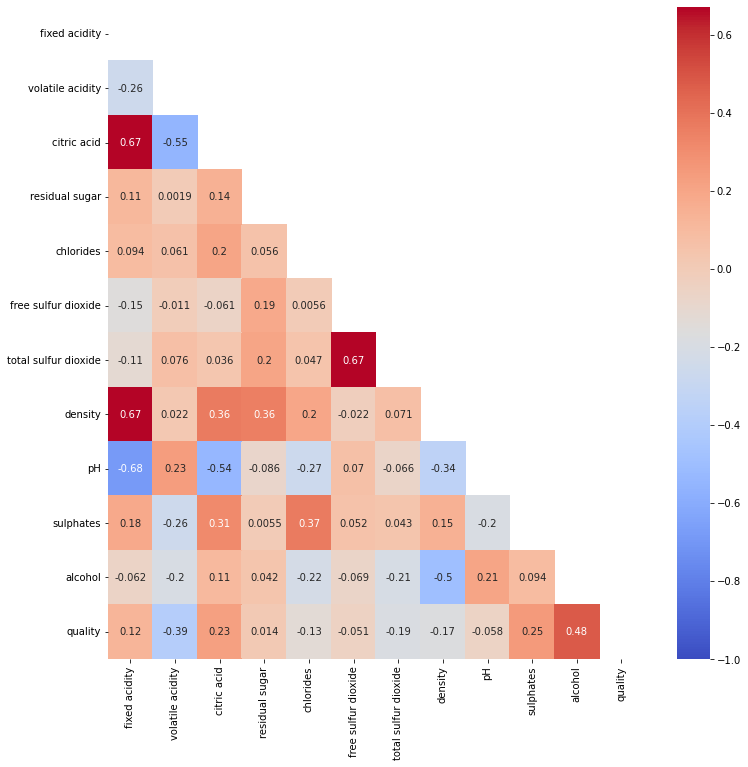

In [ ]:
## Visualizing the correlation matrix and Heatmap
plt.figure(figsize=(12,12))
cols = df.columns
mask = np.zeros_like(df[cols].corr(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df[cols].corr(), 
            vmin = -1,
            cmap='coolwarm',
            annot=True,
            mask=mask)
# plt.savefig('corr-matrix.png')
plt.show()

### Exploration of the Target Variable: Quality

We will be checking for the following:

- Unique values
- Grouping by occurrence across the target variable
- Distribution of occurrence in the target variable
- Preprocessing into more general categories to curb imbalance on target variable

In [ ]:
print(df['quality'].unique())

[5. 6. 7. 4. 8. 3.]


In [ ]:
print(df.groupby('quality').size()) ## grouping by species categories

quality
3.0     10
4.0     53
5.0    681
6.0    638
7.0    199
8.0     18
dtype: int64


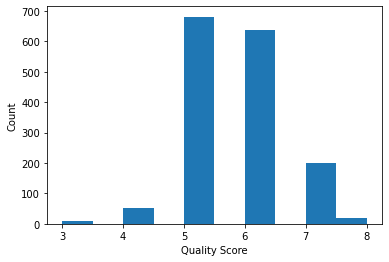

In [ ]:
## Distribution of response variable

plt.hist(df['quality'])
plt.xlabel('Quality Score')
plt.ylabel('Count')
plt.show()

In [ ]:
## Preprocessing the resposne variable into different categories to handle the imbalanced data problem
df.loc[df['quality'] == 3.0, "quality"] = "Moderate"
df.loc[df['quality'] == 4.0, "quality"] = 'Moderate'
df.loc[df['quality'] == 5.0, "quality"] = "Good"
df.loc[df['quality'] == 6.0, "quality"] = 'Very_Good'
df.loc[df['quality'] == 7.0, "quality"] = "Best"
df.loc[df['quality'] == 8.0, "quality"] = 'Best'
print(df['quality'].value_counts())


Good         681
Very_Good    638
Best         217
Moderate      63
Name: quality, dtype: int64


### Dataset after preprocessing

In [ ]:
## preprocessed dataset
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,Good
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,Good
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,Good
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,Very_Good
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,Good


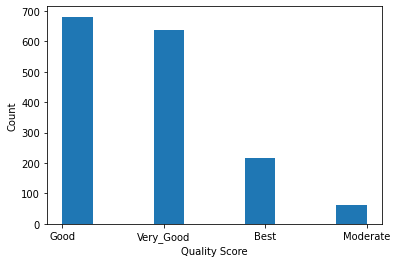

In [ ]:
## Distribution of response variable
plt.hist(df['quality'])
plt.xlabel('Quality Score')
plt.ylabel('Count')
plt.show()

### Violin Plot (Target Variable Analysis)

In [ ]:
## preparing the dataset for violin plot
data_Moderate=df[df.quality=='Moderate']
data_Good=df[df.quality=='Good']
data_Very_Good=df[df.quality=='Very_Good']
data_Best=df[df.quality=='Best']

### Box-cum-violin plot of different red wine quality in plotly

In [ ]:
enable_plotly_in_cell() ## calling for incell plotly graph visualization

#visualization
trace0 = go.Violin(
    y=data_Moderate.alcohol,
    box_visible = True,
    name = 'Moderate',
    marker = dict(
        color = 'rgb(12, 12, 140)'
    )
)
trace1 = go.Violin(
    y=data_Good.alcohol,
    box_visible = True,
    name = 'Good',
    marker = dict(
        color = 'rgb(12, 128, 128)'
    )
)
trace2 = go.Violin(
    y=data_Very_Good.alcohol,
    box_visible = True,
    name = 'Very_Good',
    marker = dict(
        color = 'rgb(255, 128, 2)'
    )
)

trace3 = go.Violin(
    y=data_Best.alcohol,
    box_visible = True,
    name = 'Best',
    marker = dict(
        color = 'rgb(12, 128, 4)'
    )
)

data2 = [trace0, trace1, trace2, trace3]

layout = dict(title = 'Alcohol (%) for different Quality of Red Wine',
              yaxis= dict(title= 'Alcohol (%)',ticklen= 5,zeroline= False),
              template='plotly_white'
             )

fig = dict(data = data2, layout = layout)
iplot(fig)

### Box-cum-scatter matrix for different numerical features

In [ ]:
enable_plotly_in_cell() ## calling for incell plotly graph visualization

# preparing data
data_1 = df.loc[:,cols[:6]]

# add index feauture in data_1
data_1 ['index'] = np.arange(1,len(data_1)+1)

# figure: in parentheses we have (our data, plot we want to see in the diagonal, index, color map,..)
fig = ff.create_scatterplotmatrix (data_1, diag='box', index='index', colormap='Portland',
                                  colormap_type='seq', height=1000, width=1000)

iplot(fig)
## To save the plot
# plt.savefig('scatterplotmatrix.png')
plt.show()

### Pairplot on the dataset 

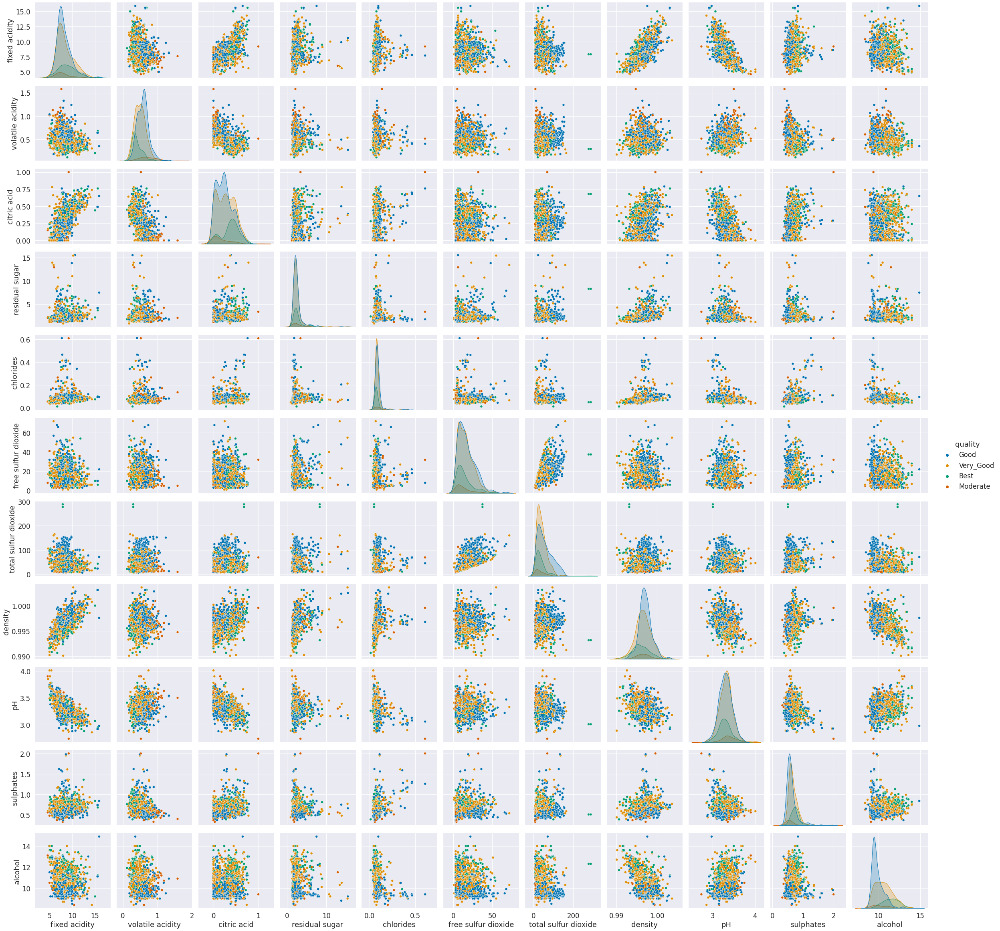

In [ ]:
## pairplot in seaborn
sns.set(font_scale=1.5)
pp = sns.pairplot(df.iloc[:, :12], hue="quality", height = 3, palette = 'colorblind')
plt.show()

### Residual Sugar vs. pH Level plot for different quality of red-wine  

In [ ]:
enable_plotly_in_cell()
fig1 = px.scatter(df, x = 'residual sugar', y = 'pH',
                  size = 'total sulfur dioxide',   color = 'quality')
fig1.update_layout(
                   title = "Residual Sugar vs. pH level",
                   title_font_size = 18,    
                   template = 'plotly_white')
fig1.update_xaxes(
                  title_text = 'pH level',
                  title_font=dict(size=18, family='Verdana',  
                                  color='black'),
                  tickfont=dict(family='Calibri', color='black', 
                                size=18))
fig1.update_yaxes(
                  title_text = "Residual Sugar", 
                  title_font=dict(size=18, family='Verdana', 
                                  color='black'),
                  tickfont=dict(family='Calibri', color='black', 
                                size=18))
fig1.show()

### 3D scatter plot for different numerical variables 

In [ ]:
enable_plotly_in_cell()
# create trace 1 that is 3d scatter
trace1 = go.Scatter3d(
    x=df['density'],
    y=df['free sulfur dioxide'],
    z=df['volatile acidity'],
    mode='markers',
    marker=dict(
        size=5,
        color=df['citric acid'],                
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    ),
    text=df['quality'])

data = [trace1]

layout = go.Layout(template='plotly_white',
                   title='density vs. free sulfur dioxide vs. volatile acidity Plot',
                   margin=dict(
                            l=0,
                            r=0,
                            b=0,
                            t=0)
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

### Distribution of different numerical variables

In [ ]:
enable_plotly_in_cell()
hist_data = [df['sulphates'],df['volatile acidity'], df['pH']]
group_labels = ['sulphates','volatile acidity', 'pH']

# import figure factory
import plotly.figure_factory as ff

fig = ff.create_distplot(hist_data, group_labels)
fig.update_layout(
                   title = "Distribution of sulphates vs. volatile acidity vs. pH Levels",
                   title_font_size = 18,    
                   template = 'plotly_white')


fig.update_yaxes(
                  title_text = "Distribution", 
                  title_font=dict(size=18, family='Verdana', 
                                  color='black'),
                  tickfont=dict(family='Calibri', color='black', 
                                size=18))
fig.show()

## Handling the Outliers

If any absolute value in a column is greater than 3 times the standard deviation, we can consider it as an outlier. In such a scenario, it is better to handle them bringing them within desired range. One way to handle this is by simply replacing the outliers with the median value for that column. 

In [ ]:
## transforing the categorical variable to numerical ones
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df_1 = df.iloc[:,:-1]
df_1['quality']= label_encoder.fit_transform(df['quality'])
print(f"Quality labels before transform: {df['quality'].unique()}")
print(f"Quality labels after transform: {df_1['quality'].unique()}")
print()

Quality labels before transform: ['Good' 'Very_Good' 'Best' 'Moderate']
Quality labels after transform: [1 3 0 2]



**Replacing the outliers with the median values**

In [ ]:
## replacing the outliers with meadian values of the columns
mean = df_1.mean()
median = df_1.median()
std = df_1.std()
outliers = (df_1 - mean).abs() > 3*std
df_1[outliers] = np.nan
print(f"No. of outliers in each columns: \n{df_1.isna().sum()}")
print('---------------------------------------------------------------')
df_1.fillna(median, inplace=True)
print(f"No. of outliers in each columns after replacement: \n{df_1.isna().sum()}")

No. of outliers in each columns: 
fixed acidity           12
volatile acidity        10
citric acid              1
residual sugar          30
chlorides               31
free sulfur dioxide     22
total sulfur dioxide    15
density                 18
pH                       8
sulphates               27
alcohol                  8
quality                  0
dtype: int64
---------------------------------------------------------------
No. of outliers in each columns after replacement: 
fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64


## ***5. Are there any interesting patterns?***

1. `fixed acidity` varies colinearly with `citric acid` and `density` and both of their correlation coefficients are comparatively higher (0.67). `free sulfur dioxide` and `total sulfur dioxide` are also co-linear. 

2. The distribution plot from each of the variable shows that different categories of red wines are univariate and its easy to interpret the distributions. Thus, all the observations have been drawn from same distribution. 

3. All the response variables have outliers according to quantile rule. Not any particular red wine but all the red wine categories participate in outliers replacement.  

4. The target variable `quality` is still unbalanced despite of rearranging the red wine categories. It can influence the ML models' prediction scores in future.

## Data Normalization

ML algorithms generally work by updating the weight values. When optimal, these values remain small throughout the learning process. However, significant numerical variations in the dataset or a different range of values across features can throw off this balance and cause the weights to update less efficiently, slowing down the learning algorithm.

Typically, we desire the feature variables to lie within the same range. Getting the values into a reasonable range is called Normalization.


In [ ]:
# %% # Normalization of the feature variables
X_1 = df_1.drop(['quality'], axis = 1)
y = df_1['quality']

## Min-max scaling has been applied on the predictor variables
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_1=pd.DataFrame(scaler.fit_transform(X_1), columns=X_1.columns)
X_1.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,0.314607,0.630435,0.000000,0.172414,0.299065,0.217391,0.201439,0.600000,0.730337,0.277108,0.192308
1,0.359551,0.826087,0.000000,0.293103,0.401869,0.521739,0.438849,0.509091,0.382022,0.421687,0.269231
2,0.359551,0.695652,0.050633,0.241379,0.373832,0.304348,0.345324,0.527273,0.449438,0.385542,0.269231
3,0.741573,0.173913,0.708861,0.172414,0.294393,0.347826,0.388489,0.618182,0.337079,0.301205,0.269231
4,0.314607,0.630435,0.000000,0.172414,0.299065,0.217391,0.201439,0.600000,0.730337,0.277108,0.192308


In [ ]:
X_1.to_csv('winequality-preprocessed-X.csv', index=False)
y.to_csv('winequality-preprocessed-Y.csv', index=False)

In [ ]:
df = pd.read_csv('winequality-preprocessed-X.csv', index_col=False)
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,0.314607,0.630435,0.000000,0.172414,0.299065,0.217391,0.201439,0.600000,0.730337,0.277108,0.192308
1,0.359551,0.826087,0.000000,0.293103,0.401869,0.521739,0.438849,0.509091,0.382022,0.421687,0.269231
2,0.359551,0.695652,0.050633,0.241379,0.373832,0.304348,0.345324,0.527273,0.449438,0.385542,0.269231
3,0.741573,0.173913,0.708861,0.172414,0.294393,0.347826,0.388489,0.618182,0.337079,0.301205,0.269231
4,0.314607,0.630435,0.000000,0.172414,0.299065,0.217391,0.201439,0.600000,0.730337,0.277108,0.192308


# Analysis: Classification

We split the data into training and test set, so that we can validate our trained model on the test set.



In [ ]:
# %% # split data into X and y
import random
from sklearn.model_selection import train_test_split
SEED=1234
random.seed(SEED)
X_1_train, X_1_test, y_train, y_test = train_test_split(X_1, y, train_size=0.75, random_state=SEED)


## Supervised Learning Techniques
- In Supervised Learning, we consider both the data samples and the labels assigned to them to train a classifier. 
- Given the existing label data, the classifier can learn a mapping function from the input data to the labels in the form of weights and biases.
- Having learned these weights and biases it can use them to calculate the labels of any new inputs.


We will be exploring four kinds of Supervised learning techniques in our study:
1. Logistic Regression (Multiclass)
2. K Nearest Neighbours (KNN) Classification
3. Support Vector Machines (SVMs)
4. XGBoost Classifier


### Multi-Class Logistic Regression 

Logistic Regression is a Supervised Machine Learning Technique, where as opposed to Linear Regression which minimizes the OLS Loss, we try to reduce the **Cross-Entropy Loss** across different classes. There are two types of Logistic Regression:   
1. Binary class (uses sigmoid activation and Binary Cross Entropy) 
2. Multiclass (uses the more general Softmax activation function)

As we have four different classes in our case, we'll be using Multiclass Logistic Regression.


In [ ]:
from sklearn import linear_model, metrics
log_mod = linear_model.LogisticRegression(multi_class='ovr', solver='liblinear')
log_mod.fit(X_1_train, y_train)
y_hat_log = log_mod.predict(X_1_test)
y_hat_log_tr = log_mod.predict(X_1_train)
accur_log = round(log_mod.score(X_1_test, y_test)*100, 2)
accur_log_tr = round(log_mod.score(X_1_train, y_train)*100, 2)
print(f"Accuracy from the logistic regression model on Train set: {accur_log_tr}%")
print(f"Accuracy from the logistic regression model on Test set: {accur_log}%")

Accuracy from the logistic regression model on Train set: 59.8%
Accuracy from the logistic regression model on Test set: 65.5%


#### Performance

We get an accuracy of 65% on test set

The Confusion Matrix shows `Good` and `Very Good` are the Best performing classes.



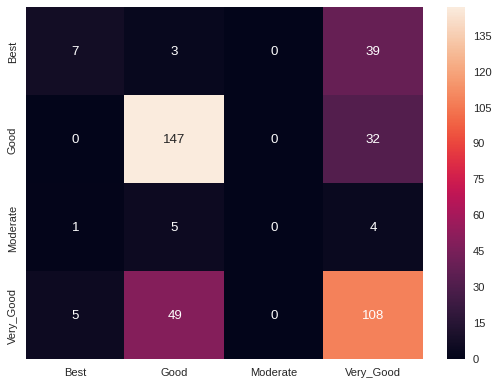

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
plt.style.use("seaborn-white")
wine_types = ['Best', 'Good', 'Moderate', 'Very_Good'  ]
sns.heatmap(confusion_matrix(y_test, y_hat_log), xticklabels=wine_types, 
            yticklabels=wine_types,annot=True ,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_test, y_hat_log,  target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.54      0.14      0.23        49
        Good       0.72      0.82      0.77       179
    Moderate       0.00      0.00      0.00        10
   Very_Good       0.59      0.67      0.63       162

    accuracy                           0.66       400
   macro avg       0.46      0.41      0.40       400
weighted avg       0.63      0.66      0.62       400



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Consequently, `Good` and `Very_Good` also have high F1 scores.

### KNN classification

The KNN classification technique learns classes/labels based on the `k` nearby neighbors for each datapoint.  

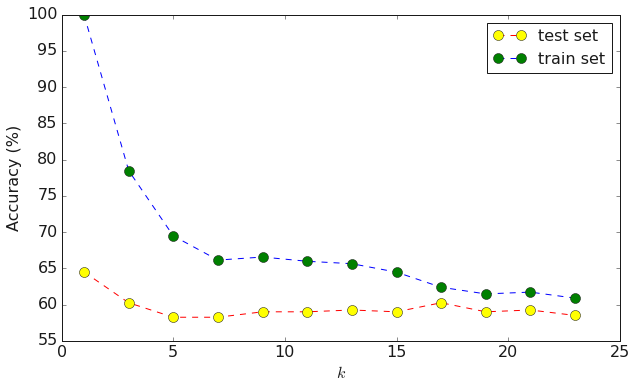

In [ ]:
# %% # Implement knn Classifier #####

# %% # Calculating error for K values between 1 and 25.
from sklearn.neighbors import KNeighborsClassifier
accur , accur_tr = [], []

for i in range(1, 25, 2):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_1_train, y_train)
    pred_i = knn.predict(X_1_test)
    pred_i_tr = knn.predict(X_1_train)
    accur.append(np.mean(pred_i == y_test)*100)
    accur_tr.append(np.mean(pred_i_tr == y_train)*100)

### plotting KNN accuraces for train and test ####
plt.figure(figsize=(10, 6))
plt.style.use('classic')
plt.plot(range(1, 25, 2), accur,  color='red', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.plot(range(1, 25, 2), accur_tr,  color='blue', linestyle='dashed', marker='o',
         markerfacecolor='green', markersize=10)
#plt.title('Error Rate in K Value', fontsize=16)
plt.xlabel(r'$k$', fontsize=16)
plt.ylabel('Accuracy (%)', fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(['test set', 'train set'], loc='best', fontsize=16)
plt.show()

In [ ]:
#Create KNN Classifier
knn = KNeighborsClassifier(n_neighbors=17)

#Train the model using the training sets
knn.fit(X_1_train, y_train)
#Predict the response for rain dataset
yknn_pred_train = knn.predict(X_1_train)
#Predict the response for test dataset
yknn_pred_test = knn.predict(X_1_test)
from sklearn.metrics import accuracy_score
# print accuracy

print("KNN_Accuracy train: {:.2f}%".format(accuracy_score(y_train, yknn_pred_train)*100))
print("KNN_Accuracy test: {:.2f}%".format(accuracy_score(y_test, yknn_pred_test)*100))

KNN_Accuracy train: 62.39%
KNN_Accuracy test: 60.25%


#### Performance

We have slightly better performance in this case, where the `Best` class also has an above avarage number of correctly classified samples. Hence `Best` has a better F1 score than in Logistic Regression

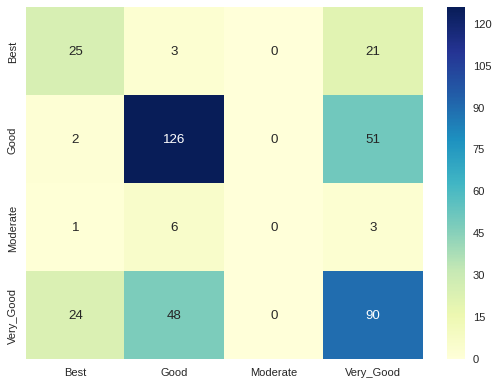

In [ ]:
sns.heatmap(confusion_matrix(y_test, yknn_pred_test), xticklabels=wine_types, 
            yticklabels=wine_types, cmap="YlGnBu", annot=True,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_test, yknn_pred_test, target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.48      0.51      0.50        49
        Good       0.69      0.70      0.70       179
    Moderate       0.00      0.00      0.00        10
   Very_Good       0.55      0.56      0.55       162

    accuracy                           0.60       400
   macro avg       0.43      0.44      0.44       400
weighted avg       0.59      0.60      0.60       400



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



### Support Vector Machines

The idea for SVMs stems from the fact that 
- Accurate classification depends on a robust decision boundary
- The points which are the trickiest to classify lie in the vicinity of this boundary, and in fact, the location of the boundary depends heavily on them. These are called Support Vectors.
- The SVM technique relies on mapping the points to such a space where the boundary and consequently gap between two classes is as wide as possible, leading to unambiguous categorization.


In [ ]:
### fitting SVM on training set ###
from sklearn import svm, datasets
rbf = svm.SVC(kernel='rbf', gamma=1, C=1, decision_function_shape='ovr').fit(X_1_train, y_train)
poly = svm.SVC(kernel='poly', degree=3, C=1, decision_function_shape='ovr').fit(X_1_train, y_train)


poly_pred_tr = poly.predict(X_1_train)
rbf_pred_tr = rbf.predict(X_1_train)
poly_pred = poly.predict(X_1_test)
rbf_pred = rbf.predict(X_1_test)


# retrieve the accuracy and print it for 2 kernel functions
accuracy_poly_tr = poly.score(X_1_train, y_train)
accuracy_rbf_tr = rbf.score(X_1_train, y_train)
accuracy_poly = poly.score(X_1_test, y_test)
accuracy_rbf = rbf.score(X_1_test, y_test)

print(f'Accuracy on train set for Polynomial Kernel: {np.round(accuracy_poly_tr*100,2)}%')
print(f'Accuracy on train set for Radial Basis Kernel: { np.round(accuracy_rbf_tr*100,2)}%')
print(f'Accuracy on test set for Polynomial Kernel: {np.round(accuracy_poly*100,2)}%')
print(f'Accuracy on test set for Radial Basis Kernel: { np.round(accuracy_rbf*100,2)}%')


Accuracy on train set for Polynomial Kernel: 70.56%
Accuracy on train set for Radial Basis Kernel: 63.8%
Accuracy on test set for Polynomial Kernel: 67.5%
Accuracy on test set for Radial Basis Kernel: 66.5%


#### Performance

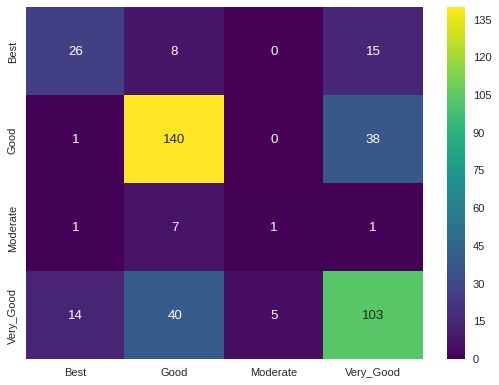

In [ ]:
cm_poly = confusion_matrix(y_test, poly_pred)
sns.heatmap(cm_poly,xticklabels=wine_types, yticklabels=wine_types, 
            cmap = 'viridis',annot=True,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_test, poly_pred, target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.62      0.53      0.57        49
        Good       0.72      0.78      0.75       179
    Moderate       0.17      0.10      0.12        10
   Very_Good       0.66      0.64      0.65       162

    accuracy                           0.68       400
   macro avg       0.54      0.51      0.52       400
weighted avg       0.67      0.68      0.67       400



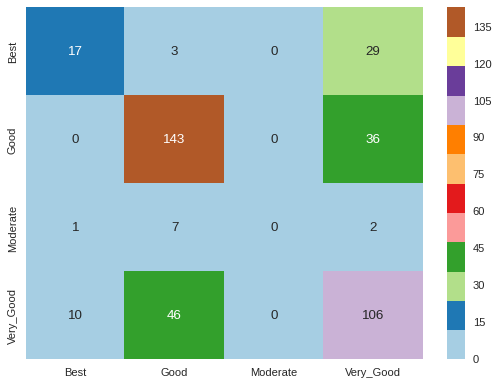

In [ ]:
cm_rbf = confusion_matrix(y_test, rbf_pred)
sns.heatmap(cm_rbf, xticklabels=wine_types, yticklabels=wine_types, 
            cmap = 'Paired', annot=True,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_test, rbf_pred, target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.61      0.35      0.44        49
        Good       0.72      0.80      0.76       179
    Moderate       0.00      0.00      0.00        10
   Very_Good       0.61      0.65      0.63       162

    accuracy                           0.67       400
   macro avg       0.48      0.45      0.46       400
weighted avg       0.64      0.67      0.65       400



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



### XGBoost Classifier

The XGBoost is a state-of-the-art classifier used for classification problems.

It is regularizing gradient boosting framework, and owes much of its performance benefits to using the Newton Rhapson method for faster gradient convergence.

In [ ]:
# grid search
from xgboost import XGBClassifier
model_xgb = XGBClassifier(random_state=SEED)
learning_rate = [0.001, 0.01, 0.1, 0.4, 0.6, 1]
max_depth = [i for i in range(2,11,2)]
param_grid = dict(learning_rate= learning_rate, max_depth = max_depth)

from sklearn.model_selection import StratifiedKFold
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=SEED)

from sklearn.model_selection import GridSearchCV
grid_search = GridSearchCV(model_xgb, param_grid, scoring="neg_log_loss", 
                           n_jobs=5, cv=kfold)
grid_result = grid_search.fit(X_1_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))


Best: -0.837522 using {'learning_rate': 0.1, 'max_depth': 4}


In [ ]:
import xgboost as xgb
# create an xgboost regression model using best parameters
xg_reg  = xgb.XGBClassifier(params = grid_result.best_params_)
xg_reg.fit(X_1_train,y_train)
preds_tr = xg_reg.predict(X_1_train) 
preds = xg_reg.predict(X_1_test)

# print accuracy
print("XGB Accuracy train: {:.2f}%".format(metrics.accuracy_score(y_train, preds_tr)*100))
print("XGB Accuracy test: {:.2f}%".format(metrics.accuracy_score(y_test, preds)*100))


XGB Accuracy train: 81.07%
XGB Accuracy test: 66.75%


#### Performance


The XGBoost Classifier can do a much better job at classifying the `Best` category, in addition to the `Good` and `Very Good` classes. It also does fairly better on the `Moderate` class.



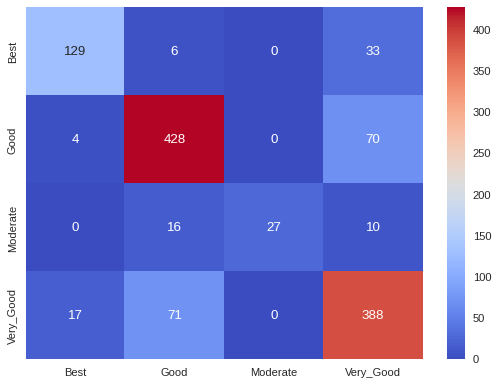

In [ ]:
cm_xgb_tr = confusion_matrix(y_train, preds_tr)
sns.heatmap(cm_xgb_tr,xticklabels=wine_types, yticklabels=wine_types, 
            cmap="coolwarm", annot=True,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_train, preds_tr, target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.86      0.77      0.81       168
        Good       0.82      0.85      0.84       502
    Moderate       1.00      0.51      0.67        53
   Very_Good       0.77      0.82      0.79       476

    accuracy                           0.81      1199
   macro avg       0.86      0.74      0.78      1199
weighted avg       0.82      0.81      0.81      1199



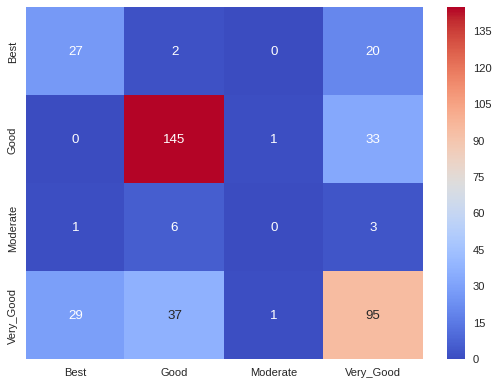

In [ ]:
cm_xgb = confusion_matrix(y_test, preds)
sns.heatmap(cm_xgb,xticklabels=wine_types, yticklabels=wine_types, 
            cmap="coolwarm", annot=True,fmt="d")
plt.show()

In [ ]:
print(classification_report(y_test, preds, target_names=wine_types))

              precision    recall  f1-score   support

        Best       0.47      0.55      0.51        49
        Good       0.76      0.81      0.79       179
    Moderate       0.00      0.00      0.00        10
   Very_Good       0.63      0.59      0.61       162

    accuracy                           0.67       400
   macro avg       0.47      0.49      0.48       400
weighted avg       0.65      0.67      0.66       400



## Comparison Among Different Supervised ML Algorithms

In [ ]:
## Preparing accuracy metrics table
algorithms = ['LogisticRegression', 'KNN', 'SVM:Poly', 'SVM:rbf', 'XGBoost']
train_accuracy = [accur_log_tr, np.round(accuracy_score(y_train, yknn_pred_train)*100,2), 
                  np.round(accuracy_poly_tr*100,2), np.round(accuracy_rbf_tr*100,2), 
                  np.round(metrics.accuracy_score(y_train, preds_tr)*100,2)]
test_accuracy = [accur_log, np.round(accuracy_score(y_test, yknn_pred_test)*100,2), 
                 np.round(accuracy_poly*100,2), np.round(accuracy_rbf*100,2), 
                 np.round(metrics.accuracy_score(y_test, preds)*100,2)]

precision_Best=[54,48,62,61,47]
precision_Good=[72,69,72,72,76]
precision_Moderate=[0,0,17,0,0]
precision_Very_Good=[59,55,66,61,63]

recall_Best=[14,51,53,35,55]
recall_Good=[82,70,78,80,81]
recall_Moderate=[0,0,10,0,0]
recall_Very_Good=[67,55,64,65,59]

f1_score_Best=[23,50,57,44,51]
f1_score_Good=[77,70,75,76,79]
f1_score_Moderate=[0,0,12,0,0]
f1_score_Very_Good=[63,55,65,63,61]
Avg_precision = [63,59,67,64,65]
Avg_recall = [66,60,68,67,67]
Avg_f1score = [62,60,67,65,66]

compare_algo = pd.DataFrame()
compare_algo['algorithms'] = algorithms
compare_algo['train_accuracy'] = train_accuracy
compare_algo['test_accuracy'] = test_accuracy
compare_algo['precision_Best'] = precision_Best
compare_algo['precision_Good'] = precision_Good
compare_algo['precision_Moderate'] = precision_Moderate
compare_algo['precision_Very_Good'] = precision_Very_Good
compare_algo['recall_Best'] = recall_Best
compare_algo['recall_Good'] = recall_Good
compare_algo['recall_Moderate'] = recall_Moderate
compare_algo['recall_Very_Good'] = recall_Very_Good
compare_algo['f1_score_Best'] = f1_score_Best
compare_algo['f1_score_Good'] = f1_score_Good
compare_algo['f1_score_Moderate'] = f1_score_Moderate
compare_algo['f1_score_Very_Good'] = f1_score_Very_Good
compare_algo['Avg_precision'] = Avg_precision
compare_algo['Avg_recall'] = Avg_recall
compare_algo['Avg_f1score'] = Avg_f1score
compare_algo

,algorithms,train_accuracy,test_accuracy,precision_Best,precision_Good,precision_Moderate,precision_Very_Good,recall_Best,recall_Good,recall_Moderate,recall_Very_Good,f1_score_Best,f1_score_Good,f1_score_Moderate,f1_score_Very_Good,Avg_precision,Avg_recall,Avg_f1score
0,LogisticRegression,59.80,65.50,54,72,0,59,14,82,0,67,23,77,0,63,63,66,62
1,KNN,62.39,60.25,48,69,0,55,51,70,0,55,50,70,0,55,59,60,60
2,SVM:Poly,70.56,67.50,62,72,17,66,53,78,10,64,57,75,12,65,67,68,67
3,SVM:rbf,63.80,66.50,61,72,0,61,35,80,0,65,44,76,0,63,64,67,65
4,XGBoost,81.07,66.75,47,76,0,63,55,81,0,59,51,79,0,61,65,67,66


In [ ]:
enable_plotly_in_cell()
#visualization
#create trace1
trace1 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['train_accuracy'],
                name = "Train Accuracy",
                marker = dict(color = 'rgba(255, 58, 255, 0.4)',
                             line=dict(color='rgb(0,0,0)',width=1.5)))
# create trace2 
trace2 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['test_accuracy'],
                name = "Test Accuracy",
                marker = dict(color = 'rgba(15, 15, 250, 0.4)',
                              line=dict(color='rgb(0,0,0)',width=1.5))
                )
data4 = [trace1, trace2]
layout = go.Layout(barmode = "group", title='Comparison of Train and Test accuracies for Different Algorithms',
                   xaxis=dict(title='Algorithms'),
                   yaxis=dict( title='Accuracy (%)'),
                   template='plotly_white')
fig = go.Figure(data=data4, layout=layout)
iplot(fig)

The accuracy comparison for all the four types of algorithms applied on the dataset for wine quality (class labels) predictions. It could be visible from the plot that XGBoost algorithm provides maximum accuracy on train and test sets. This is due to for XGBoost model, hyper parameter tuning has been performed in a grid search method for the best set pf results. 

In [ ]:
enable_plotly_in_cell()

## Visualization

# create trace1
trace1 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['precision_Best'],
                name = "precision_Best",
                marker = dict(color = 'rgba(20, 58, 255, 0.4)',
                             line=dict(color='rgb(0,0,0)',width=1.5))
                )
# create trace2 
trace2 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['precision_Good'],
                name = "precision_Good",
                marker = dict(color = 'rgba(115, 15, 20, 0.4)',
                              line=dict(color='rgb(0,0,0)',width=1.5))
                )
# create trace3
trace3 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['precision_Moderate'],
                name = "precision_Moderate",
                marker = dict(color = 'rgba(255, 5, 25, 0.4)',
                             line=dict(color='rgb(0,0,0)',width=1.5)))
# create trace4 
trace4 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['precision_Very_Good'],
                name = "precision_Very_Good",
                marker = dict(color = 'rgba(15, 15, 14, 0.4)',
                              line=dict(color='rgb(0,0,0)',width=1.5))
                )

data1 = [trace1, trace2, trace3, trace4]
layout = go.Layout(barmode = "group", 
                   title='Comparison of Precision values for different categories from Different Algorithms',
                   xaxis=dict(title='Algorithms'),
                   yaxis=dict( title='Accuracy (%)'),
                   template='plotly_white')
fig = go.Figure(data=data1, layout=layout)
iplot(fig)

If the precision metric has been compared for different algorithms, it could be seen that the precision value for the ‘Good’ category wines are the highest from all the algorithms. The good quality wines are the most labeled ones in the training set that’s why the precision of this category is also higher than the rest. The ‘Moderate’ quality wines are the least present in the trainset and produces almost zero precision level for most of the algorithms except SVM (polynomial kernel). 

In [ ]:
enable_plotly_in_cell()
#visualization
#create trace1
trace1 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['recall_Best'],
                name = "recall_Best",
                marker = dict(color = 'rgba(150, 255, 200, 0.4)',
                             line=dict(color='rgb(0,0,0)',width=1.5))
                )
# create trace2 
trace2 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['recall_Good'],
                name = "recall_Good",
                marker = dict(color = 'rgba(215, 215, 20, 0.4)',
                              line=dict(color='rgb(0,0,0)',width=1.5))
                )
# create trace3
trace3 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['recall_Moderate'],
                name = "recall_Moderate",
                marker = dict(color = 'rgba(255, 5, 25, 0.4)',
                             line=dict(color='rgb(0,0,0)',width=1.5)))
# create trace4 
trace4 = go.Bar(
                x = compare_algo.algorithms,
                y = compare_algo['recall_Very_Good'],
                name = "recall_Very_Good",
                marker = dict(color = 'rgba(115, 05, 114, 0.4)',
                              line=dict(color='rgb(0,0,0)',width=1.5))
                )

data0 = [trace1, trace2, trace3, trace4]
layout = go.Layout(barmode = "group", 
                   title='Comparison of Recall values for different categories from Different Algorithms',
                   xaxis=dict(title='Algorithms'),
                   yaxis=dict( title='Accuracy (%)'),
                   template='plotly_white')
fig = go.Figure(data=data0, layout=layout)
iplot(fig)

The recall comparison is also similar to precision one which depicts ‘Moderate’ quality wine prediction gets penalized the most! The median and average of recall value from all the algorithms is higher than the precision and F1 score metrics. 

In [ ]:
enable_plotly_in_cell()
#visualization
trace0 = go.Violin(
    y=compare_algo.Avg_precision,
    box_visible = True,
    name = 'Average Precision',
    marker = dict(color = 'rgb(12, 12, 140)')
)
trace1 = go.Violin(
    y=compare_algo.Avg_recall,
    box_visible = True,
    name = 'Average Recall',
    marker = dict(color = 'rgb(255, 155, 128)')
)

trace2 = go.Violin(
    y=compare_algo.Avg_f1score,
    box_visible = True,
    name = 'Average F1score',
    marker = dict(color = 'rgb(12, 128, 128)')
)

data = [trace0,trace1,trace2]

layout = dict(title = 'Comparison between Precision, Recall and F1_score Distributions for Different Algorithms',
              yaxis= dict(title= 'Weighted statistical metric (%)',ticklen= 5,zeroline= False),
              template='plotly_white'
             )

fig = dict(data = data, layout = layout)
iplot(fig)

In recall and precision trade-off gets very important when the classes are widely imbalanced like in the present study. Thus, most of its predicted labels in the unbalanced classes could be incorrectly identified compared to the training classes. 

## Unsupervised Learning: K-means Clustering

For K means, we first set a count K for no. of clusters. With that, we set K initial cluster centers (we can just select a random sample from existing training set)

After this, we need to perform below Steps 1 and 2 until convergence, which will be the point when these cluster centers no longer change much.

1. **Update Cluster members**: Calculate distance of every point with every current cluster center, and assign it to the nearest one.

2. **Update Cluster Center**: Of every current set of x points assigned to a cluster, calculate a new cluster center by calculating the Centroid of all points in a given cluster.


In [ ]:
## Applying PCA on the preprocessed data
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca_fit = pca.fit_transform(X_1)
pca_data = pd.DataFrame(data = pca_fit, columns = ['PC_1', 'PC_2'])
print(f"Variance Explained: {pca.explained_variance_ratio_}")
print(f"Total variance explained: {np.round(np.sum(pca.explained_variance_ratio_)*100,2)}%")

Variance Explained: [0.30807908 0.20771313]
Total variance explained: 51.58%


### Elbow Curve: WCSS (Within Cluster Sum of Squares) Loss


For various K values, plot the sum of the squared distance of *every* point from its cluster center. This is called the WCSS loss



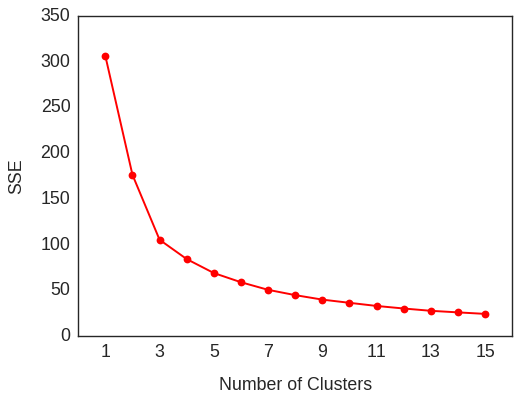

In [ ]:
#  SSE value-lot for each k; k:- {1:15}

## defining the arguments for kmeans
km_kwargs = {'init':"k-means++", 'n_init':10, 'max_iter':300, 'random_state':SEED}

sse = [] ## empty list to add the sse values

from sklearn.cluster import KMeans
for k in range(1, 16, 1):
    kmean = KMeans(n_clusters=k, **km_kwargs)
    kmean.fit(pca_data) 
    sse.append(kmean.inertia_)
    # dunn_.append(dunn(dist, kmean.labels_))

## plot for sse values for different k
plt.style.use("seaborn-white")
plt.figure(figsize=(7,5))
plt.plot(range(1, 16, 1), sse, 'ok-', color = 'red')
plt.xticks(range(1, 16, 2), size=16)
plt.yticks(size=16)
plt.xlabel("Number of Clusters", size=16, labelpad=14)
plt.ylabel("SSE", size=16, labelpad=14)
plt.show()

For values of K=4 to 5 and above, this loss ceases to decrease substantially and stagnates.





In [ ]:
!pip install kneed

In [ ]:
from kneed import KneeLocator
kl = KneeLocator(range(1, 16), sse, curve="convex", direction="decreasing")
print(f"Optimal no. of clusters from kmeans: {kl.elbow}")

Optimal no. of clusters from kmeans: 4


### Optimal k-means

Using the Silhouette score, we can deduce an optimal K value for clusters.

In [ ]:
## kmeans for k=4 (optimal k)
kmean = KMeans(init="k-means++", n_clusters=kl.elbow, n_init=10, max_iter=300, random_state=1234)
kmean.fit(pca_data)

## Different statistics for k=4
# The lowest rss value
print(f"Lowest inertia value :{np.round(kmean.inertia_,2)}")
print()
# Final locations of the centroid in n-feature-dimension
print(f"final locations of centroids in n-feature-dimension: \n{kmean.cluster_centers_}")
print()
# min number of iterations required to converge
print(f"No. of iteration required to converge: {kmean.n_iter_}")
print()
# Calculate silhouette Score for k = 4
from sklearn.metrics import silhouette_score
score = silhouette_score(pca_data, kmean.labels_, metric='euclidean')
print(f"Optimal silhouette score for optimal k={kl.elbow}: {np.round(score,2)}")

Lowest inertia value :83.76

final locations of centroids in n-feature-dimension: 
[[-0.03752414  0.35583421]
 [ 0.1089018  -0.18531704]
 [-0.33647302 -0.12479742]
 [ 0.52956716 -0.06798493]]

No. of iteration required to converge: 9

Optimal silhouette score for optimal k=4: 0.39


### Dunn Index

In [ ]:
!pip install validclust

In [ ]:
from sklearn.metrics import pairwise_distances
from validclust import dunn
dist = pairwise_distances(pca_data)
silhouette_coefficients = [] ## empty list for adding coeffs
dunn_ = []
# the range starts from k=2
for k in range(2, 16):
    kmean = KMeans(n_clusters=k, **km_kwargs)
    kmean.fit(pca_data)
    score = silhouette_score(pca_data, kmean.labels_)
    silhouette_coefficients.append(score)
    dunn_.append(dunn(dist, kmean.labels_))



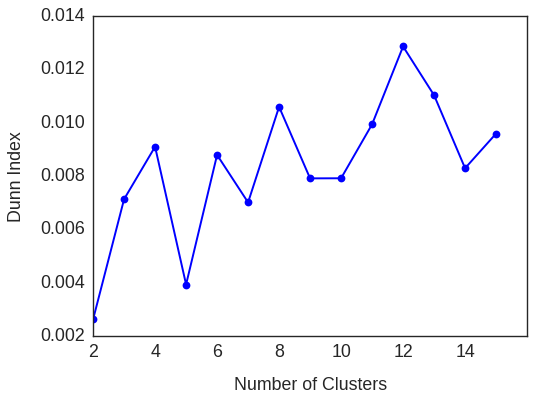

In [ ]:
## plot for Dunn Index different k's
# plt.style.use("_classic_test_patch")
plt.figure(figsize=(7,5))
plt.plot(range(2, 16, 1),  dunn_, 'ok-', color = 'blue')
plt.xticks(range(2, 16, 2), size=16)
plt.yticks(size=16)
plt.xlabel("Number of Clusters", size=16, labelpad=14)
plt.ylabel("Dunn Index", size=16, labelpad=14)
plt.show()

In [ ]:
## determines best k for Silhouette Coefficient
dunn_best = max(dunn_)
k_best_index = dunn_.index(dunn_best)
k_clust = [i for i in range(2,16)]
k_best = k_clust[k_best_index]
print("Optimum Number of Clusters from Dunn Index:", k_best)

Optimum Number of Clusters from Dunn Index: 12


### Silhouette Coefficients 

The Silhouette Coefficient measures the degree of closeness within a cluster vs it's separation from other clusters 

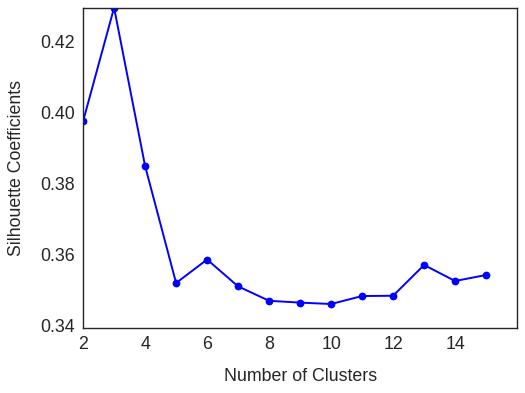

In [ ]:
## plot for Silhouette Coefficients different k's

plt.figure(figsize=(7,5))
plt.plot(range(2, 16, 1),  silhouette_coefficients, 'ok-', color = 'blue')
plt.xticks(range(2, 16, 2), size=16)
plt.yticks(size=16)
plt.xlabel("Number of Clusters", size=16, labelpad=14)
plt.ylabel("Silhouette Coefficients", size=16, labelpad=14)

plt.show()

In [ ]:
## determines best k for Silhouette Coefficient
sil_best = max(silhouette_coefficients)
k_best_index = silhouette_coefficients.index(sil_best)
k_clust = [i for i in range(2,16)]
k_best = k_clust[k_best_index]
print("Optimum Number of Clusters from silhouette Scores:", k_best)

Optimum Number of Clusters from silhouette Scores: 3


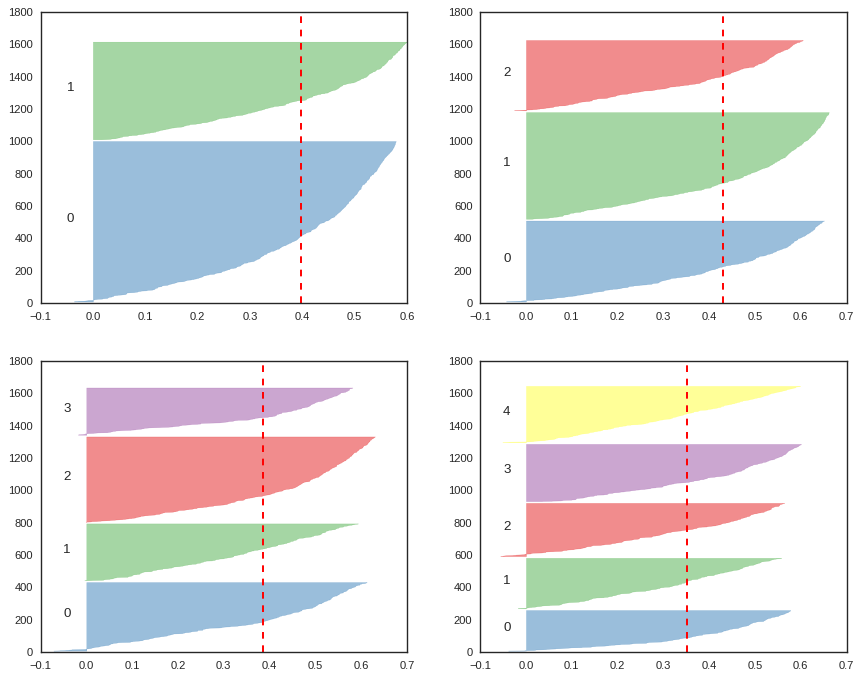

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer
## plot for Silhouette Coefficients for k:-{2,5}
fig, ax = plt.subplots(2, 2, figsize=(13,10))
for i in range(2,6):
    kmean = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=300, random_state=SEED)
    axs, modd = ((i//2)-1, i%2)
    visualization = SilhouetteVisualizer(kmean, colors='sns_colorblind', ax=ax[axs][modd], title= i )
    visualization.fit(pca_data)

# Comparison of Results 

1. Thus, the XGBoost model performs exceptionally well on the train set but could not identify the minority classes in test set. To overcome this situation, SVM (kernel=polynomial) comes to the rescue to handle the severe imbalanced dataset outperforming all other algorithms and classifying 67.5% correct wines in the test set. Logistic regression and SVM (kernel=RBF) perform better in test set than train set. KNN (k=17) generalizes the model very well.
2. The accuracy comparison for all the four types of algorithms applied on the dataset for wine quality (class labels) predictions. It could be visible from the plot that XGBoost algorithm provides maximum accuracy on train and test sets. This is due to for XGBoost model, hyper parameter tuning has been performed in a grid search method for the best set pf results. 
3. If the precision metric has been compared for different algorithms, it could be seen that the precision value for the ‘Good’ category wines are the highest from all the algorithms. The good quality wines are the most labeled ones in the training set that’s why the precision of this category is also higher than the rest. The ‘Moderate’ quality wines are the least present in the trainset and produces almost zero precision level for most of the algorithms except SVM (polynomial kernel). 
4. The recall comparison is also similar to precision one which depicts ‘Moderate’ quality wine prediction gets penalized the most! The median and average of recall value from all the algorithms is higher than the precision and F1 score metrics. 
5. In recall and precision trade-off gets very important when the classes are widely imbalanced like in the present study. Thus, most of its predicted labels in the unbalanced classes could be incorrectly identified compared to the training classes. 
6. **Summary of unsupervised learning:** The k-means clustering elbow curve detected the optimal cluster to be 4, satisfying the wine classification labels. The Silhouette coefficient detected the optimal cluster to be 3. The Dunn Index identified the no. of the cluster to be 12, which needs more explorations because it does not satisfy the primary clustering purpose of optimal groups. 


*Similar explanation has been included in the report (report_sreya_dhar_prateeksha_singh_assignment2.pdf) too*

# References

1. https://plotly.com/python/
2. https://plotly.com/graphing-libraries/
3. https://seaborn.pydata.org/generated/seaborn.pairplot.html
4. https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html
5. https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html
6. https://dzone.com/articles/kmeans-silhouette-score-explained-with-python-exam
7. https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
8. https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
9. https://scikit-learn.org/stable/user_guide.html